# Accessing Cloud Optimized GeoTIFF (COG) - S3 Direct Access

## Summary

In this notebook, we will access data for the ECOSTRESS Tiled Land Surface Temperature and Emissivity Instantaneous L2 Global 70 m V002 data product. These data are archived and distributed as Cloud Optimized GeoTIFF (COG) files, one file for each variable.

We will access a single COG file, Land Surface Temperature (LST), from inside the AWS cloud (us-west-2 region, specifically) and load it into Python as an `xarray` `dataarray`. This approach leverages S3 native protocols for efficient access to the data.

## Requirements

### 1. AWS instance running in us-west-2

NASA Earthdata Cloud data in S3 can be directly accessed via temporary credentials; this access is limited to requests made within the US West (Oregon) (code: us-west-2) AWS region.

### 2. ECOSTRESS Early Adopter¶
ECOSTRESS build 7 is only open to individuals identified as early adopters. As such ECOSTRESS discovery and access is managed by an access control list. If you are not on the access control list, you will not be able to complete the exercise as written below.

### 3. Earthdata Login

An Earthdata Login account is required to access data, as well as discover restricted data, from the NASA Earthdata system. Thus, to access NASA data, you need Earthdata Login. Please visit https://urs.earthdata.nasa.gov to register and manage your Earthdata Login account. This account is free to create and only takes a moment to set up.

### 4. netrc File

You will need a netrc file containing your NASA Earthdata Login credentials in order to execute the notebooks. A netrc file can be created manually within text editor and saved to your home directory. For additional information see: [Authentication for NASA Earthdata](https://nasa-openscapes.github.io/2021-Cloud-Hackathon/tutorials/04_NASA_Earthdata_Authentication.html#authentication-via-netrc-file).

## Learning Objectives

- how to retrieve temporary S3 credentials for in-region direct S3 bucket access
- how to perform in-region direct access of HLS Cloud Optimized geoTIFF (COG) files in S3
- how to plot the data

---

### Import Packages

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
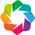

In [1]:
import os
import requests 
import boto3
from osgeo import gdal
import rasterio as rio
from rasterio.session import AWSSession
import rioxarray
import geopandas
from shapely.geometry import Polygon
from shapely.ops import transform
import pyproj
from pyproj import Proj
import hvplot.xarray
import holoviews as hv
import geoviews as gv
gv.extension('bokeh', 'matplotlib')

## Get Temporary AWS Credentials

Direct S3 access is achieved by passing NASA supplied temporary credentials to AWS so we can interact with S3 objects from applicable Earthdata Cloud buckets. For now, each NASA DAAC has different AWS credentials endpoints. Below are some of the credential endpoints to various DAACs:

In [2]:
s3_cred_endpoint = {
    'podaac':'https://archive.podaac.earthdata.nasa.gov/s3credentials',
    'gesdisc': 'https://data.gesdisc.earthdata.nasa.gov/s3credentials',
    'lpdaac':'https://data.lpdaac.earthdatacloud.nasa.gov/s3credentials',
    'ornldaac': 'https://data.ornldaac.earthdata.nasa.gov/s3credentials',
    'ghrcdaac': 'https://data.ghrc.earthdata.nasa.gov/s3credentials'
}

Create a function to make a request to an endpoint for temporary credentials. Remember, each DAAC has their own endpoint and credentials are not usable for cloud data from other DAACs.

In [3]:
def get_temp_creds(provider):
    return requests.get(s3_cred_endpoint[provider]).json()

In [4]:
temp_creds_req = get_temp_creds('lpdaac')
#temp_creds_req

## Workspace Environment Setup

For this exercise, we are going to open up a context manager for the notebook using the rasterio.env module to store the required GDAL and AWS configurations we need to access the data in Earthdata Cloud. While the context manager is open (rio_env.__enter__()) we will be able to run the open or get data commands that would typically be executed within a with statement, thus allowing us to more freely interact with the data. We’ll close the context (rio_env.__exit__()) at the end of the notebook.

Create a `boto3` Session object using your temporary credentials. This Session is used to pass credentials and configuration to AWS so we can interact wit S3 objects from applicable buckets.

In [5]:
session = boto3.Session(aws_access_key_id=temp_creds_req['accessKeyId'], 
                        aws_secret_access_key=temp_creds_req['secretAccessKey'],
                        aws_session_token=temp_creds_req['sessionToken'],
                        region_name='us-west-2')

GDAL environment variables must be configured to access COGs in Earthdata Cloud. Geospatial data access Python packages like rasterio and rioxarray depend on GDAL, leveraging GDAL’s “Virtual File Systems” to read remote files. GDAL has a lot of environment variables that control it’s behavior. Changing these settings can mean the difference being able to access a file or not. They can also have an impact on the performance.

In [6]:
rio_env = rio.Env(AWSSession(session),
                  GDAL_DISABLE_READDIR_ON_OPEN='TRUE',
                  GDAL_HTTP_COOKIEFILE=os.path.expanduser('~/cookies.txt'),
                  GDAL_HTTP_COOKIEJAR=os.path.expanduser('~/cookies.txt'))
rio_env.__enter__()

In this example we're interested in the ECOSTRESS Tiled Land Surface Temperature and Emissivity data collection from NASA's [LP DAAC](https://lpdaac.usgs.gov/) in Earthdata Cloud. Below we specify the S3 URL to the data asset in Earthdata Cloud. This URL can be found via [Earthdata Search](../tutorials/01_Earthdata_Search.md) or programmatically through the [CMR](https://nasa-openscapes.github.io/2021-Cloud-Hackathon/tutorials/01_Data_Discovery_CMR.html) and [CMR-STAC](https://nasa-openscapes.github.io/2021-Cloud-Hackathon/tutorials/02_Data_Discovery_CMR-STAC_API.html) APIs.

In [7]:
#s3_url = 's3://lp-prod-protected/HLSL30.020/HLS.L30.T10SGD.2020272T183449.v2.0/HLS.L30.T10SGD.2020272T183449.v2.0.B04.tif'
s3_url = 's3://lp-prod-protected/ECO_L2T_LSTE.002/ECOv002_L2T_LSTE_21241_015_10SGD_20220405T034009_0700_01/ECOv002_L2T_LSTE_21241_015_10SGD_20220405T034009_0700_01_LST.tif'

## Direct In-region Access

Read in the ECOSTRESS Tiles LST S3 URL into our workspace using `rioxarray`, an extension of `xarray` used to read geospatial data. 

In [8]:
da = rioxarray.open_rasterio(s3_url, chunks='auto')
da

<xarray.DataArray (band: 1, y: 1568, x: 1568)>
dask.array<open_rasterio-d1d4613f005e6ea0be9b5c4c040f9aaf<this-array>, shape=(1, 1568, 1568), dtype=float32, chunksize=(1, 1568, 1568), chunktype=numpy.ndarray>
Coordinates:
  * band         (band) int64 1
  * x            (x) float64 7e+05 7.001e+05 7.001e+05 ... 8.096e+05 8.097e+05
  * y            (y) float64 3.9e+06 3.9e+06 3.9e+06 ... 3.79e+06 3.79e+06
    spatial_ref  int64 0
Attributes:
    _FillValue:    nan
    scale_factor:  1.0
    add_offset:    0.0

The file is read into Python as an `xarray` `dataarray` with a **band**, **x**, and **y** dimension. In this example the **band** dimension is meaningless, so we'll use the `squeeze()` function to remove **band** as a dimension. 

In [9]:
da_lst = da.squeeze('band', drop=True)
da_lst

<xarray.DataArray (y: 1568, x: 1568)>
dask.array<getitem, shape=(1568, 1568), dtype=float32, chunksize=(1568, 1568), chunktype=numpy.ndarray>
Coordinates:
  * x            (x) float64 7e+05 7.001e+05 7.001e+05 ... 8.096e+05 8.097e+05
  * y            (y) float64 3.9e+06 3.9e+06 3.9e+06 ... 3.79e+06 3.79e+06
    spatial_ref  int64 0
Attributes:
    _FillValue:    nan
    scale_factor:  1.0
    add_offset:    0.0

Plot the `dataarray`, representing the L30 red band, using `hvplot`.

In [10]:
da_lst.hvplot.image(x = 'x', y = 'y', crs = 'EPSG:32610', cmap='jet', rasterize=False, width=800, height=600, tiles='EsriImagery', colorbar=True)

:Overlay
   .Tiles.I :Tiles   [x,y]
   .Image.I :Image   [x,y]   (value)

## Define the Region of Interest for Clipping

We'll read in our GeoJSON file of our points of interest and create bounding box that contains a points coordinates

In [11]:
points = field = geopandas.read_file('../../data/TNC_fall_2020.geojson')

Extract the min/max values for the y and x axis     

In [12]:
minx, miny, maxx, maxy = points.geometry.total_bounds
minx, miny, maxx, maxy

(-120.45264628215773,
 34.51050622261265,
 -120.40432447545712,
 34.532398755692206)

Order the coordinates for the bounding box counterclockwise 

In [13]:
coords = [
    (minx, miny),
    (maxx, miny),
    (maxx, maxy),
    (minx, maxy)
]

Create a shapely polygon

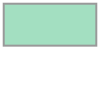

In [14]:
feature_shape = Polygon(coords)
feature_shape

In [15]:
base = gv.tile_sources.EsriImagery.opts(width=650, height=500)
farmField = gv.Polygons(feature_shape).opts(line_color='yellow', line_width=10, color=None)
base * farmField

:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]

Let's take a look at the bounding coordinate values.

Note, the values above are in decimal degrees and represent the longitude and latitude for the lower left corner and upper right corner respectively.

In [16]:
feature_shape.bounds

(-120.45264628215773,
 34.51050622261265,
 -120.40432447545712,
 34.532398755692206)

Get the projection information from the HLS file

In [17]:
src_proj = da_lst.rio.crs
src_proj

CRS.from_epsg(32610)

Transform coordinates from lat lon (units = dd) to UTM (units = m)

In [18]:
geo_CRS = Proj('+proj=longlat +datum=WGS84 +no_defs', preserve_units=True)   # Source coordinate system of the ROI

In [19]:
project = pyproj.Transformer.from_proj(geo_CRS, src_proj)                    # Set up the transformation

In [20]:
fsUTM = transform(project.transform, feature_shape)
fsUTM.bounds

(733792.5759279637, 3821708.6775865103, 738290.9586659562, 3824250.087197832)

The coordinates for our feature have now been converted to source raster projection. Note the difference in the values between `feature_shape.bounds` (in geographic) and `fsUTM.bounds` (in UTM projection).

Now we can clip our ECOSTRESS LST file to our region of insterest!

## Access and clip the ECOSTRESS LST COG

We can now use our transformed ROI bounding box to clip the HLS S3 object we accessed before. We'll use the `rio.clip`

In [21]:
da_lst_clip = rioxarray.open_rasterio(s3_url, chunks='auto').squeeze('band', drop=True).rio.clip([fsUTM])

In [22]:
da_lst_clip

<xarray.DataArray (y: 36, x: 65)>
dask.array<copy, shape=(36, 65), dtype=float32, chunksize=(36, 65), chunktype=numpy.ndarray>
Coordinates:
  * y            (y) float64 3.824e+06 3.824e+06 ... 3.822e+06 3.822e+06
  * x            (x) float64 7.338e+05 7.339e+05 ... 7.382e+05 7.383e+05
    spatial_ref  int64 0
Attributes:
    scale_factor:  1.0
    add_offset:    0.0
    _FillValue:    nan

In [23]:
da_lst_clip.hvplot.image(x = 'x', y = 'y', crs = 'EPSG:32610', cmap='jet', rasterize=False, width=800, height=600, tiles='EsriImagery', colorbar=True)

:Overlay
   .Tiles.I :Tiles   [x,y]
   .Image.I :Image   [x,y]   (value)

Exit the context manager.

In [24]:
rio_env.__exit__()

---

## Resources

[Direct S3 Data Access with rioxarray](https://nasa-openscapes.github.io/2021-Cloud-Hackathon/tutorials/05_Data_Access_Direct_S3.html)

[Direct_S3_Access__gdalvrt](https://github.com/NASA-Openscapes/2021-Cloud-Hackathon/blob/main/tutorials/Additional_Resources__Direct_S3_Access__gdalvrt.ipynb)

[Direct_S3_Access__rioxarray_clipping](https://github.com/NASA-Openscapes/2021-Cloud-Hackathon/blob/main/tutorials/Additional_Resources__Direct_S3_Access__rioxarray_clipping.ipynb)

[Getting Started with Cloud-Native Harmonized Landsat Sentinel-2 (HLS) Data in R](https://lpdaac.usgs.gov/resources/e-learning/getting-started-with-cloud-native-harmonized-landsat-sentinel-2-hls-data-in-r/)